In [1]:
from __future__ import print_function
import timeit

import numpy as np
import scipy.stats as stats
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import xgboost as xgb

from sklearn import metrics
from sklearn.model_selection import train_test_split, cross_val_score, cross_val_predict
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression, LogisticRegressionCV

from sklearn.svm import SVC
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import confusion_matrix, mean_squared_error
from sklearn.ensemble import VotingClassifier, RandomForestClassifier

from imblearn.over_sampling import SMOTE

import re
from sklearn.metrics import log_loss
import matplotlib.pyplot as plt

import sklearn.ensemble
import lime
import lime.lime_tabular


In [2]:
file = './data_cleaned.csv'
data = pd.read_csv(file)

In [3]:
data.head()

,Unnamed: 0,advertiser,industry,job_category,job_description,job_title,job_type,link,location,posting_date,search_word,sub_location,salary_cleaned,job_categorised,industry_categorised
0,0,Ambition Technology,Information & Communication Technology,Engineering - Software,"Our client, a Major Australian University are ...",Senior Data Engineer,Full Time,https://www.seek.com.au/job/39024106?type=stan...,Brisbane,15 May 2019,data scientist,CBD & Inner Suburbs,120000.0,seinor data engineer,technology
1,1,Randstad - Technologies,Information & Communication Technology,Database Development & Administration,The Data Engineer (Cloud/Data Lake) will play ...,Data Engineer - Cloud / Data Lake,Full Time,https://www.seek.com.au/job/39015517?type=stan...,Brisbane,14 May 2019,data scientist,CBD & Inner Suburbs,111526.0,data engineer,technology
2,2,PRA,Information & Communication Technology,Consultants,Brisbane CBD location - Permanent full time ro...,Data Engineer,Full Time,https://www.seek.com.au/job/38998989?type=stan...,Brisbane,11 May 2019,data scientist,CBD & Inner Suburbs,111526.0,data engineer,technology
3,3,Synergy Placements,Information & Communication Technology,Developers/Programmers,Contract role Large QLD organisation Brisbane...,Data Engineer Brisbane,Contract/Temp,https://www.seek.com.au/job/38957267?type=stan...,Brisbane,7 May 2019,data scientist,CBD & Inner Suburbs,208000.0,data engineer,technology
4,4,GRIT Talent Consulting,Information & Communication Technology,Database Development & Administration,We are seeking an experienced Data Engineer fo...,Data Engineer,Contract/Temp,https://www.seek.com.au/job/38943938?type=stan...,Brisbane,3 May 2019,data scientist,NaN,208000.0,data engineer,technology


In [4]:
data.shape

(652, 15)

In [5]:
data.drop(['Unnamed: 0','link','search_word'],axis=1,inplace=True)

In [6]:
data.head()

,advertiser,industry,job_category,job_description,job_title,job_type,location,posting_date,sub_location,salary_cleaned,job_categorised,industry_categorised
0,Ambition Technology,Information & Communication Technology,Engineering - Software,"Our client, a Major Australian University are ...",Senior Data Engineer,Full Time,Brisbane,15 May 2019,CBD & Inner Suburbs,120000.0,seinor data engineer,technology
1,Randstad - Technologies,Information & Communication Technology,Database Development & Administration,The Data Engineer (Cloud/Data Lake) will play ...,Data Engineer - Cloud / Data Lake,Full Time,Brisbane,14 May 2019,CBD & Inner Suburbs,111526.0,data engineer,technology
2,PRA,Information & Communication Technology,Consultants,Brisbane CBD location - Permanent full time ro...,Data Engineer,Full Time,Brisbane,11 May 2019,CBD & Inner Suburbs,111526.0,data engineer,technology
3,Synergy Placements,Information & Communication Technology,Developers/Programmers,Contract role Large QLD organisation Brisbane...,Data Engineer Brisbane,Contract/Temp,Brisbane,7 May 2019,CBD & Inner Suburbs,208000.0,data engineer,technology
4,GRIT Talent Consulting,Information & Communication Technology,Database Development & Administration,We are seeking an experienced Data Engineer fo...,Data Engineer,Contract/Temp,Brisbane,3 May 2019,NaN,208000.0,data engineer,technology


## Creating X and y for Logistic Regression

In [7]:
X=pd.DataFrame()

for n in ['industry_categorised','job_categorised','location','job_type']:
    new_dummy = pd.get_dummies(data[n],prefix=n, prefix_sep='_',drop_first=True)
    data = pd.concat([data,new_dummy],axis=1)
    X = pd.concat([X,new_dummy],axis=1)

In [8]:
data.salary_cleaned.describe()

count       652.000000
mean     130334.720092
std       41913.732639
min       31200.000000
25%      103466.500000
50%      123809.000000
75%      150000.000000
max      390000.000000
Name: salary_cleaned, dtype: float64

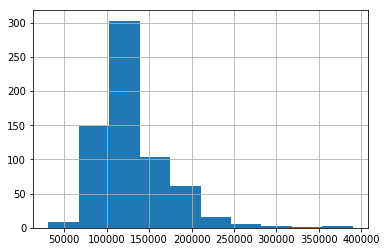

In [9]:
data.salary_cleaned.hist()

In [10]:
# bins = [60000,90000,120000,150000,180000,210000,240000,270000]
# labels = [1,2,3,4,5,6,7,8,9]
# data['binned_sal'] = pd.cut(data['salary_cleaned'], bins=bins, labels=labels)

In [11]:
def binning(x):
    if x < 70000:
        return 1
    elif x < 100000:
        return 2
    elif x < 130000:
        return 3
    elif x < 160000:
        return 4
    elif x < 190000:
        return 5
    else:
        return 6

In [12]:
data['binned_sal'] = data['salary_cleaned'].apply(binning)

In [13]:
data.binned_sal.value_counts()

3    268
4    182
2     72
6     60
5     59
1     11
Name: binned_sal, dtype: int64

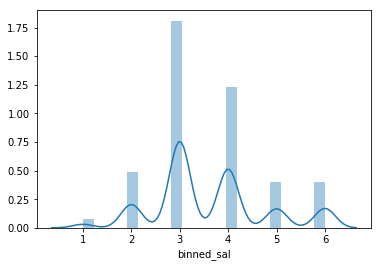

In [14]:
sns.distplot(data.binned_sal)

In [15]:
y = data.binned_sal

In [16]:
y.dtypes

dtype('int64')

In [17]:
X_train, X_test, y_train, y_test = train_test_split(X,y, train_size = 0.8,test_size=0.2,random_state=42)

## Logistic Regression

In [18]:
lr = LogisticRegression(solver = 'lbfgs',multi_class='auto')
lr.fit(X_train,y_train)

LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
          intercept_scaling=1, max_iter=100, multi_class='auto',
          n_jobs=None, penalty='l2', random_state=None, solver='lbfgs',
          tol=0.0001, verbose=0, warm_start=False)

In [19]:
%timeit lr.fit(X_train,y_train)

57.8 ms ± 7.77 ms per loop (mean ± std. dev. of 7 runs, 10 loops each)


In [20]:
baseline = 220/652

scores = cross_val_score(lr,X_train,y_train,cv=10)
accuracy_score_train = scores.mean()
accuracy_score_test = lr.score(X_test,y_test)

y_pred = lr.predict_proba(X_test)
log_loss_test = log_loss(y_test,y_pred)

y_pred = lr.predict_proba(X_train)
log_loss_train = log_loss(y_train,y_pred)

print('baseline: ',baseline)
print('-------------------------------')
print("accuracy score - train: ",accuracy_score_train)
print("accuracy score - test: ",accuracy_score_test)
print('-------------------------------')
print("log loss score - train: ",log_loss_train)
print("log loss score - test: ",log_loss_test)

baseline:  0.3374233128834356
-------------------------------
accuracy score - train:  0.6392652039044935
accuracy score - test:  0.6335877862595419
-------------------------------
log loss score - train:  0.982666323749616
log loss score - test:  1.0525513028127091


In [21]:
lr_features = pd.DataFrame()
lr_features['importance'] = np.std(X, 0)*lr.coef_[0]
lr_features['abs_importance'] = lr_features['importance'].apply(lambda x: np.abs(x))
lr_features.sort_values('abs_importance',ascending=False,inplace=True)
lr_features

,importance,abs_importance
job_categorised_data engineer,0.375120,0.375120
industry_categorised_technology,-0.325814,0.325814
job_categorised_data analyst,0.285860,0.285860
location_Melbourne,0.224648,0.224648
industry_categorised_other,-0.198658,0.198658
job_categorised_data scientist,-0.154251,0.154251
job_categorised_seinor data analyst,-0.110422,0.110422
job_categorised_business intelligence,0.103805,0.103805
job_categorised_seinor business intelligence,-0.103083,0.103083
job_categorised_seinor data scientist,-0.085701,0.085701


## Logistic Regression CV

In [22]:
lr_ridge = LogisticRegressionCV(penalty='l2',Cs=200,cv=20)
lr_ridge.fit(X_train,y_train)

C:\Users\Roy\Anaconda3\lib\site-packages\sklearn\linear_model\logistic.py:460: FutureWarning: Default multi_class will be changed to 'auto' in 0.22. Specify the multi_class option to silence this warning.
  "this warning.", FutureWarning)
C:\Users\Roy\Anaconda3\lib\site-packages\sklearn\model_selection\_split.py:652: Warning: The least populated class in y has only 10 members, which is too few. The minimum number of members in any class cannot be less than n_splits=20.
  % (min_groups, self.n_splits)), Warning)


LogisticRegressionCV(Cs=200, class_weight=None, cv=20, dual=False,
           fit_intercept=True, intercept_scaling=1.0, max_iter=100,
           multi_class='warn', n_jobs=None, penalty='l2',
           random_state=None, refit=True, scoring=None, solver='lbfgs',
           tol=0.0001, verbose=0)

In [23]:
lr_ridge.score(X_train,y_train)

0.6353166986564299

In [24]:
lr_ridge.score(X_test,y_test)

0.5801526717557252

In [25]:
lr_lasso = LogisticRegressionCV(penalty='l1', solver='liblinear', Cs=200, cv=10)
lr_lasso.fit(X_train, y_train)

C:\Users\Roy\Anaconda3\lib\site-packages\sklearn\linear_model\logistic.py:460: FutureWarning: Default multi_class will be changed to 'auto' in 0.22. Specify the multi_class option to silence this warning.
  "this warning.", FutureWarning)
C:\Users\Roy\Anaconda3\lib\site-packages\sklearn\svm\base.py:922: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
C:\Users\Roy\Anaconda3\lib\site-packages\sklearn\svm\base.py:922: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
C:\Users\Roy\Anaconda3\lib\site-packages\sklearn\svm\base.py:922: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
C:\Users\Roy\Anaconda3\lib\site-packages\sklearn\svm\base.py:922: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "t

C:\Users\Roy\Anaconda3\lib\site-packages\sklearn\svm\base.py:922: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
C:\Users\Roy\Anaconda3\lib\site-packages\sklearn\svm\base.py:922: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
C:\Users\Roy\Anaconda3\lib\site-packages\sklearn\svm\base.py:922: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
C:\Users\Roy\Anaconda3\lib\site-packages\sklearn\svm\base.py:922: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
C:\Users\Roy\Anaconda3\lib\site-packages\sklearn\svm\base.py:922: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", Convergenc

C:\Users\Roy\Anaconda3\lib\site-packages\sklearn\svm\base.py:922: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
C:\Users\Roy\Anaconda3\lib\site-packages\sklearn\svm\base.py:922: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
C:\Users\Roy\Anaconda3\lib\site-packages\sklearn\svm\base.py:922: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
C:\Users\Roy\Anaconda3\lib\site-packages\sklearn\svm\base.py:922: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
C:\Users\Roy\Anaconda3\lib\site-packages\sklearn\svm\base.py:922: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", Convergenc

C:\Users\Roy\Anaconda3\lib\site-packages\sklearn\svm\base.py:922: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
C:\Users\Roy\Anaconda3\lib\site-packages\sklearn\svm\base.py:922: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
C:\Users\Roy\Anaconda3\lib\site-packages\sklearn\svm\base.py:922: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
C:\Users\Roy\Anaconda3\lib\site-packages\sklearn\svm\base.py:922: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
C:\Users\Roy\Anaconda3\lib\site-packages\sklearn\svm\base.py:922: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", Convergenc

C:\Users\Roy\Anaconda3\lib\site-packages\sklearn\svm\base.py:922: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
C:\Users\Roy\Anaconda3\lib\site-packages\sklearn\svm\base.py:922: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
C:\Users\Roy\Anaconda3\lib\site-packages\sklearn\svm\base.py:922: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
C:\Users\Roy\Anaconda3\lib\site-packages\sklearn\svm\base.py:922: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
C:\Users\Roy\Anaconda3\lib\site-packages\sklearn\svm\base.py:922: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", Convergenc

C:\Users\Roy\Anaconda3\lib\site-packages\sklearn\svm\base.py:922: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
C:\Users\Roy\Anaconda3\lib\site-packages\sklearn\svm\base.py:922: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
C:\Users\Roy\Anaconda3\lib\site-packages\sklearn\svm\base.py:922: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
C:\Users\Roy\Anaconda3\lib\site-packages\sklearn\svm\base.py:922: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
C:\Users\Roy\Anaconda3\lib\site-packages\sklearn\svm\base.py:922: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", Convergenc

C:\Users\Roy\Anaconda3\lib\site-packages\sklearn\svm\base.py:922: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
C:\Users\Roy\Anaconda3\lib\site-packages\sklearn\svm\base.py:922: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
C:\Users\Roy\Anaconda3\lib\site-packages\sklearn\svm\base.py:922: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
C:\Users\Roy\Anaconda3\lib\site-packages\sklearn\svm\base.py:922: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
C:\Users\Roy\Anaconda3\lib\site-packages\sklearn\svm\base.py:922: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", Convergenc

LogisticRegressionCV(Cs=200, class_weight=None, cv=10, dual=False,
           fit_intercept=True, intercept_scaling=1.0, max_iter=100,
           multi_class='warn', n_jobs=None, penalty='l1',
           random_state=None, refit=True, scoring=None, solver='liblinear',
           tol=0.0001, verbose=0)

In [26]:
lr_lasso.score(X_train,y_train)

0.31861804222648754

In [27]:
lr_lasso.score(X_test,y_test)

0.31297709923664124

## SVM

In [45]:
parameters = {'C':[0.001,0.25,0.5,0.75,1,10],
              'kernel':['linear','rbf'],
              'gamma':['scale',0.001,0.01,0.1,1,2,3],
              'decision_function_shape':['ovo','ovr']}

In [46]:
svm = SVC(probability=True,random_state=42)
grid_search = GridSearchCV(svm,param_grid=parameters,cv=3,n_jobs=3)
grid_search.fit(X_train,y_train)

C:\Users\Roy\Anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)


GridSearchCV(cv=3, error_score='raise-deprecating',
       estimator=SVC(C=1.0, cache_size=200, class_weight=None, coef0=0.0,
  decision_function_shape='ovr', degree=3, gamma='auto_deprecated',
  kernel='rbf', max_iter=-1, probability=True, random_state=42,
  shrinking=True, tol=0.001, verbose=False),
       fit_params=None, iid='warn', n_jobs=3,
       param_grid={'C': [0.001, 0.25, 0.5, 0.75, 1, 10], 'kernel': ['linear', 'rbf'], 'gamma': ['scale', 0.001, 0.01, 0.1, 1, 2, 3], 'decision_function_shape': ['ovo', 'ovr']},
       pre_dispatch='2*n_jobs', refit=True, return_train_score='warn',
       scoring=None, verbose=0)

In [47]:
%timeit grid_search.fit(X_train,y_train)

8.16 µs ± 575 ns per loop (mean ± std. dev. of 7 runs, 100000 loops each)


C:\Users\Roy\Anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\Roy\Anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\Roy\Anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\Roy\Anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning:

9.26 s ± 270 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


C:\Users\Roy\Anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)


In [48]:
grid_search.best_params_

{'C': 10, 'decision_function_shape': 'ovo', 'gamma': 1, 'kernel': 'rbf'}

In [65]:
%timeit SVC(C=10,kernel='rbf',decision_function_shape='ovo',gamma=1).fit(X_train,y_train)

14.7 ms ± 474 µs per loop (mean ± std. dev. of 7 runs, 100 loops each)


In [49]:
svm = grid_search

In [50]:
baseline = 220/652

accuracy_score_train = grid_search.best_score_

accuracy_score_test = grid_search.score(X_test,y_test)

y_pred = grid_search.predict_proba(X_test)
log_loss_test = log_loss(y_test,y_pred)

y_pred = grid_search.predict_proba(X_train)
log_loss_train = log_loss(y_train,y_pred)

print('baseline: ',baseline)
print('-------------------------------')
print("accuracy score - train: ",accuracy_score_train)
print("accuracy score - test: ",accuracy_score_test)
print('-------------------------------')
print("log loss score - train: ",log_loss_train)
print("log loss score - test: ",log_loss_test)

baseline:  0.3374233128834356
-------------------------------
accuracy score - train:  0.8253358925143954
accuracy score - test:  0.8244274809160306
-------------------------------
log loss score - train:  0.5625767336467343
log loss score - test:  0.7020208969890209


### SMOTE

In [436]:
smt=SMOTE(k_neighbors=5)
X2_train,y2_train = smt.fit_sample(X_train,y_train)
np.bincount(y2_train)

array([  0, 215, 215, 215, 215, 215, 215], dtype=int64)

In [438]:
lr2 = LogisticRegression()
scores = cross_val_score(lr2,X2_train,y2_train,cv=10)
print("scores: ",scores.mean())

C:\Users\Roy\Anaconda3\lib\site-packages\sklearn\linear_model\logistic.py:433: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
C:\Users\Roy\Anaconda3\lib\site-packages\sklearn\linear_model\logistic.py:460: FutureWarning: Default multi_class will be changed to 'auto' in 0.22. Specify the multi_class option to silence this warning.
  "this warning.", FutureWarning)
C:\Users\Roy\Anaconda3\lib\site-packages\sklearn\linear_model\logistic.py:433: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
C:\Users\Roy\Anaconda3\lib\site-packages\sklearn\linear_model\logistic.py:460: FutureWarning: Default multi_class will be changed to 'auto' in 0.22. Specify the multi_class option to silence this warning.
  "this warning.", FutureWarning)
C:\Users\Roy\Anaconda3\lib\site-packages\sklearn\linear_model\logistic.py:433: FutureWarning: Default solver will 

scores:  0.5801948051948053


In [440]:
lr2.fit(X2_train,y2_train)
lr2.score(X_test,y_test)

C:\Users\Roy\Anaconda3\lib\site-packages\sklearn\linear_model\logistic.py:433: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
C:\Users\Roy\Anaconda3\lib\site-packages\sklearn\linear_model\logistic.py:460: FutureWarning: Default multi_class will be changed to 'auto' in 0.22. Specify the multi_class option to silence this warning.
  "this warning.", FutureWarning)


0.5267175572519084

#### smote - SVM

In [442]:
parameters = {'C':[0.001,0.25,0.5,0.75,1,10],
              'kernel':['linear','rbf'],
              'gamma':['scale',0.001,0.01,0.1,1,2,3],
              'decision_function_shape':['ovo','ovr']}

In [443]:
svm2 = SVC(probability=True,random_state=42)
grid_search2 = GridSearchCV(svm2,param_grid=parameters,cv=3,n_jobs=3)
grid_search2.fit(X2_train,y2_train)

C:\Users\Roy\Anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)


GridSearchCV(cv=3, error_score='raise-deprecating',
       estimator=SVC(C=1.0, cache_size=200, class_weight=None, coef0=0.0,
  decision_function_shape='ovr', degree=3, gamma='auto_deprecated',
  kernel='rbf', max_iter=-1, probability=True, random_state=42,
  shrinking=True, tol=0.001, verbose=False),
       fit_params=None, iid='warn', n_jobs=3,
       param_grid={'C': [0.001, 0.25, 0.5, 0.75, 1, 10], 'kernel': ['linear', 'rbf'], 'gamma': ['scale', 0.001, 0.01, 0.1, 1, 2, 3], 'decision_function_shape': ['ovo', 'ovr']},
       pre_dispatch='2*n_jobs', refit=True, return_train_score='warn',
       scoring=None, verbose=0)

In [450]:
grid_search2.best_score_

0.7806201550387597

In [451]:
grid_search2.score(X_test,y_test)

0.8091603053435115

In [452]:
grid_search2.best_params_

{'C': 10, 'decision_function_shape': 'ovo', 'gamma': 1, 'kernel': 'rbf'}

In [453]:
svm = grid_search2

In [454]:
y_pred = grid_search2.predict_proba(X_test)
log_loss(y_test,y_pred)

0.6982700493541434

## Random Forest

In [32]:
forest = RandomForestClassifier(max_depth=5,max_leaf_nodes=30)
forest.fit(X_train,y_train)

C:\Users\Roy\Anaconda3\lib\site-packages\sklearn\ensemble\forest.py:245: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)


RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
                       max_depth=5, max_features='auto', max_leaf_nodes=30,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=10,
                       n_jobs=None, oob_score=False, random_state=None,
                       verbose=0, warm_start=False)

In [33]:
%timeit forest = RandomForestClassifier(max_depth=5,max_leaf_nodes=30)
%timeit forest.fit(X_train,y_train)

6.06 µs ± 433 ns per loop (mean ± std. dev. of 7 runs, 100000 loops each)
13.4 ms ± 574 µs per loop (mean ± std. dev. of 7 runs, 100 loops each)


In [34]:
baseline = 220/652

accuracy_score_train = forest.score(X_train,y_train)

accuracy_score_test = forest.score(X_test,y_test)

y_pred = forest.predict_proba(X_test)
log_loss_test = log_loss(y_test,y_pred)

y_pred = forest.predict_proba(X_train)
log_loss_train = log_loss(y_train,y_pred)

print('baseline: ',baseline)
print('-------------------------------')
print("accuracy score - train: ",accuracy_score_train)
print("accuracy score - test: ",accuracy_score_test)
print('-------------------------------')
print("log loss score - train: ",log_loss_train)
print("log loss score - test: ",log_loss_test)

baseline:  0.3374233128834356
-------------------------------
accuracy score - train:  0.710172744721689
accuracy score - test:  0.6335877862595419
-------------------------------
log loss score - train:  0.85704200788733
log loss score - test:  0.9799387647665012


In [25]:
forest_features = pd.DataFrame()
forest_features['feature'] = X.columns
forest_features['importance'] = forest.feature_importances_
forest_features.sort_values('importance',ascending=False).head(10)

,feature,importance
14,job_type_Full Time,0.212035
13,job_type_Contract/Temp,0.122978
1,industry_categorised_technology,0.112079
11,location_Melbourne,0.100447
12,location_Sydney,0.081122
3,job_categorised_data analyst,0.080540
4,job_categorised_data engineer,0.074804
0,industry_categorised_other,0.070460
2,job_categorised_business intelligence,0.048744
5,job_categorised_data scientist,0.028189


In [26]:
import os
from sklearn.tree import export_graphviz
import six
# import pydot
from sklearn import tree

export_graphviz(estimator, out_file='tree.dot',feature_names=X_train.columns,
                rounded=True,proportion=False,precision=2,filled=True)

os.system('dot -Tpng tree.dot -o tree.png')

NameError: name 'estimator' is not defined

## XGboost

In [464]:
from sklearn.metrics import precision_score

dtrain = xgb.DMatrix(X_train,label=y_train)
dtest = xgb.DMatrix(X_test,label=y_test)

C:\Users\Roy\Anaconda3\lib\site-packages\xgboost\core.py:587: FutureWarning: Series.base is deprecated and will be removed in a future version
  if getattr(data, 'base', None) is not None and \


In [465]:
param = {'max_depth': 10,'eta': 0.2,'verbosity': 1,'objective': 'multi:softprob','num_class': 7,'alpha':0.8,'lambda':50} 
num_round = 300

In [466]:
bst = xgb.train(param,dtrain,num_round)

In [467]:
preds=bst.predict(dtrain)
best_preds = np.asarray([np.argmax(line) for line in preds])

In [468]:
print(precision_score(y_train, best_preds, average='macro'))

C:\Users\Roy\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1143: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)


0.7065411906099244


In [469]:
bst.eval

<bound method Booster.eval of <xgboost.core.Booster object at 0x000001B04CA88668>>

In [470]:
preds=bst.predict(dtest)
best_preds = np.asarray([np.argmax(line) for line in preds])

In [471]:
print(precision_score(y_test, best_preds, average='macro'))

C:\Users\Roy\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1143: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)


0.7096224173430056


#### Wrapper

In [55]:
from xgboost import XGBClassifier
model = XGBClassifier(max_depth= 7,eta= 0.1,verbosity= 1,objective= 'multi:softprob',num_class= 7,alpha=0.8,reg_lambda=50)
eval_set = [(X_train, y_train), (X_test, y_test)]
model.fit(X_train,y_train,eval_metric=['merror','mlogloss'],eval_set=eval_set, verbose=True)

[0]	validation_0-merror:0.410749	validation_0-mlogloss:1.74058	validation_1-merror:0.40458	validation_1-mlogloss:1.74408
[1]	validation_0-merror:0.410749	validation_0-mlogloss:1.69377	validation_1-merror:0.40458	validation_1-mlogloss:1.70048
[2]	validation_0-merror:0.410749	validation_0-mlogloss:1.65087	validation_1-merror:0.40458	validation_1-mlogloss:1.66039
[3]	validation_0-merror:0.414587	validation_0-mlogloss:1.61153	validation_1-merror:0.40458	validation_1-mlogloss:1.62419
[4]	validation_0-merror:0.414587	validation_0-mlogloss:1.57522	validation_1-merror:0.40458	validation_1-mlogloss:1.59043
[5]	validation_0-merror:0.416507	validation_0-mlogloss:1.54185	validation_1-merror:0.427481	validation_1-mlogloss:1.55988
[6]	validation_0-merror:0.416507	validation_0-mlogloss:1.51061	validation_1-merror:0.427481	validation_1-mlogloss:1.5311
[7]	validation_0-merror:0.416507	validation_0-mlogloss:1.48191	validation_1-merror:0.427481	validation_1-mlogloss:1.50443
[8]	validation_0-merror:0.4165

[67]	validation_0-merror:0.234165	validation_0-mlogloss:0.866647	validation_1-merror:0.274809	validation_1-mlogloss:0.942846
[68]	validation_0-merror:0.234165	validation_0-mlogloss:0.863572	validation_1-merror:0.274809	validation_1-mlogloss:0.940209
[69]	validation_0-merror:0.234165	validation_0-mlogloss:0.859621	validation_1-merror:0.274809	validation_1-mlogloss:0.937422
[70]	validation_0-merror:0.234165	validation_0-mlogloss:0.856179	validation_1-merror:0.274809	validation_1-mlogloss:0.934387
[71]	validation_0-merror:0.234165	validation_0-mlogloss:0.852247	validation_1-merror:0.274809	validation_1-mlogloss:0.931179
[72]	validation_0-merror:0.220729	validation_0-mlogloss:0.848678	validation_1-merror:0.274809	validation_1-mlogloss:0.928667
[73]	validation_0-merror:0.220729	validation_0-mlogloss:0.845001	validation_1-merror:0.274809	validation_1-mlogloss:0.925703
[74]	validation_0-merror:0.220729	validation_0-mlogloss:0.84191	validation_1-merror:0.274809	validation_1-mlogloss:0.923105
[

XGBClassifier(alpha=0.8, base_score=0.5, booster='gbtree',
       colsample_bylevel=1, colsample_bytree=1, eta=0.1, gamma=0,
       learning_rate=0.1, max_delta_step=0, max_depth=7,
       min_child_weight=1, missing=None, n_estimators=100, n_jobs=1,
       nthread=None, num_class=7, objective='multi:softprob',
       random_state=0, reg_alpha=0, reg_lambda=50, scale_pos_weight=1,
       seed=None, silent=True, subsample=1, verbosity=1)

In [60]:
%timeit model.fit(X_train,y_train,eval_metric=['merror','mlogloss'],eval_set=eval_set, verbose=True)

[0]	validation_0-merror:0.410749	validation_0-mlogloss:1.74058	validation_1-merror:0.40458	validation_1-mlogloss:1.74408
[1]	validation_0-merror:0.410749	validation_0-mlogloss:1.69377	validation_1-merror:0.40458	validation_1-mlogloss:1.70048
[2]	validation_0-merror:0.410749	validation_0-mlogloss:1.65087	validation_1-merror:0.40458	validation_1-mlogloss:1.66039
[3]	validation_0-merror:0.414587	validation_0-mlogloss:1.61153	validation_1-merror:0.40458	validation_1-mlogloss:1.62419
[4]	validation_0-merror:0.414587	validation_0-mlogloss:1.57522	validation_1-merror:0.40458	validation_1-mlogloss:1.59043
[5]	validation_0-merror:0.416507	validation_0-mlogloss:1.54185	validation_1-merror:0.427481	validation_1-mlogloss:1.55988
[6]	validation_0-merror:0.416507	validation_0-mlogloss:1.51061	validation_1-merror:0.427481	validation_1-mlogloss:1.5311
[7]	validation_0-merror:0.416507	validation_0-mlogloss:1.48191	validation_1-merror:0.427481	validation_1-mlogloss:1.50443
[8]	validation_0-merror:0.4165

[67]	validation_0-merror:0.234165	validation_0-mlogloss:0.866647	validation_1-merror:0.274809	validation_1-mlogloss:0.942846
[68]	validation_0-merror:0.234165	validation_0-mlogloss:0.863572	validation_1-merror:0.274809	validation_1-mlogloss:0.940209
[69]	validation_0-merror:0.234165	validation_0-mlogloss:0.859621	validation_1-merror:0.274809	validation_1-mlogloss:0.937422
[70]	validation_0-merror:0.234165	validation_0-mlogloss:0.856179	validation_1-merror:0.274809	validation_1-mlogloss:0.934387
[71]	validation_0-merror:0.234165	validation_0-mlogloss:0.852247	validation_1-merror:0.274809	validation_1-mlogloss:0.931179
[72]	validation_0-merror:0.220729	validation_0-mlogloss:0.848678	validation_1-merror:0.274809	validation_1-mlogloss:0.928667
[73]	validation_0-merror:0.220729	validation_0-mlogloss:0.845001	validation_1-merror:0.274809	validation_1-mlogloss:0.925703
[74]	validation_0-merror:0.220729	validation_0-mlogloss:0.84191	validation_1-merror:0.274809	validation_1-mlogloss:0.923105
[

[34]	validation_0-merror:0.270633	validation_0-mlogloss:1.05541	validation_1-merror:0.274809	validation_1-mlogloss:1.106
[35]	validation_0-merror:0.268714	validation_0-mlogloss:1.04716	validation_1-merror:0.274809	validation_1-mlogloss:1.09803
[36]	validation_0-merror:0.268714	validation_0-mlogloss:1.03806	validation_1-merror:0.274809	validation_1-mlogloss:1.09037
[37]	validation_0-merror:0.268714	validation_0-mlogloss:1.02965	validation_1-merror:0.274809	validation_1-mlogloss:1.08222
[38]	validation_0-merror:0.268714	validation_0-mlogloss:1.02237	validation_1-merror:0.274809	validation_1-mlogloss:1.07516
[39]	validation_0-merror:0.268714	validation_0-mlogloss:1.01511	validation_1-merror:0.274809	validation_1-mlogloss:1.06835
[40]	validation_0-merror:0.268714	validation_0-mlogloss:1.00782	validation_1-merror:0.274809	validation_1-mlogloss:1.06145
[41]	validation_0-merror:0.268714	validation_0-mlogloss:1.00019	validation_1-merror:0.274809	validation_1-mlogloss:1.05523
[42]	validation_0-

[0]	validation_0-merror:0.410749	validation_0-mlogloss:1.74058	validation_1-merror:0.40458	validation_1-mlogloss:1.74408
[1]	validation_0-merror:0.410749	validation_0-mlogloss:1.69377	validation_1-merror:0.40458	validation_1-mlogloss:1.70048
[2]	validation_0-merror:0.410749	validation_0-mlogloss:1.65087	validation_1-merror:0.40458	validation_1-mlogloss:1.66039
[3]	validation_0-merror:0.414587	validation_0-mlogloss:1.61153	validation_1-merror:0.40458	validation_1-mlogloss:1.62419
[4]	validation_0-merror:0.414587	validation_0-mlogloss:1.57522	validation_1-merror:0.40458	validation_1-mlogloss:1.59043
[5]	validation_0-merror:0.416507	validation_0-mlogloss:1.54185	validation_1-merror:0.427481	validation_1-mlogloss:1.55988
[6]	validation_0-merror:0.416507	validation_0-mlogloss:1.51061	validation_1-merror:0.427481	validation_1-mlogloss:1.5311
[7]	validation_0-merror:0.416507	validation_0-mlogloss:1.48191	validation_1-merror:0.427481	validation_1-mlogloss:1.50443
[8]	validation_0-merror:0.4165

[67]	validation_0-merror:0.234165	validation_0-mlogloss:0.866647	validation_1-merror:0.274809	validation_1-mlogloss:0.942846
[68]	validation_0-merror:0.234165	validation_0-mlogloss:0.863572	validation_1-merror:0.274809	validation_1-mlogloss:0.940209
[69]	validation_0-merror:0.234165	validation_0-mlogloss:0.859621	validation_1-merror:0.274809	validation_1-mlogloss:0.937422
[70]	validation_0-merror:0.234165	validation_0-mlogloss:0.856179	validation_1-merror:0.274809	validation_1-mlogloss:0.934387
[71]	validation_0-merror:0.234165	validation_0-mlogloss:0.852247	validation_1-merror:0.274809	validation_1-mlogloss:0.931179
[72]	validation_0-merror:0.220729	validation_0-mlogloss:0.848678	validation_1-merror:0.274809	validation_1-mlogloss:0.928667
[73]	validation_0-merror:0.220729	validation_0-mlogloss:0.845001	validation_1-merror:0.274809	validation_1-mlogloss:0.925703
[74]	validation_0-merror:0.220729	validation_0-mlogloss:0.84191	validation_1-merror:0.274809	validation_1-mlogloss:0.923105
[

[34]	validation_0-merror:0.270633	validation_0-mlogloss:1.05541	validation_1-merror:0.274809	validation_1-mlogloss:1.106
[35]	validation_0-merror:0.268714	validation_0-mlogloss:1.04716	validation_1-merror:0.274809	validation_1-mlogloss:1.09803
[36]	validation_0-merror:0.268714	validation_0-mlogloss:1.03806	validation_1-merror:0.274809	validation_1-mlogloss:1.09037
[37]	validation_0-merror:0.268714	validation_0-mlogloss:1.02965	validation_1-merror:0.274809	validation_1-mlogloss:1.08222
[38]	validation_0-merror:0.268714	validation_0-mlogloss:1.02237	validation_1-merror:0.274809	validation_1-mlogloss:1.07516
[39]	validation_0-merror:0.268714	validation_0-mlogloss:1.01511	validation_1-merror:0.274809	validation_1-mlogloss:1.06835
[40]	validation_0-merror:0.268714	validation_0-mlogloss:1.00782	validation_1-merror:0.274809	validation_1-mlogloss:1.06145
[41]	validation_0-merror:0.268714	validation_0-mlogloss:1.00019	validation_1-merror:0.274809	validation_1-mlogloss:1.05523
[42]	validation_0-

[0]	validation_0-merror:0.410749	validation_0-mlogloss:1.74058	validation_1-merror:0.40458	validation_1-mlogloss:1.74408
[1]	validation_0-merror:0.410749	validation_0-mlogloss:1.69377	validation_1-merror:0.40458	validation_1-mlogloss:1.70048
[2]	validation_0-merror:0.410749	validation_0-mlogloss:1.65087	validation_1-merror:0.40458	validation_1-mlogloss:1.66039
[3]	validation_0-merror:0.414587	validation_0-mlogloss:1.61153	validation_1-merror:0.40458	validation_1-mlogloss:1.62419
[4]	validation_0-merror:0.414587	validation_0-mlogloss:1.57522	validation_1-merror:0.40458	validation_1-mlogloss:1.59043
[5]	validation_0-merror:0.416507	validation_0-mlogloss:1.54185	validation_1-merror:0.427481	validation_1-mlogloss:1.55988
[6]	validation_0-merror:0.416507	validation_0-mlogloss:1.51061	validation_1-merror:0.427481	validation_1-mlogloss:1.5311
[7]	validation_0-merror:0.416507	validation_0-mlogloss:1.48191	validation_1-merror:0.427481	validation_1-mlogloss:1.50443
[8]	validation_0-merror:0.4165

[67]	validation_0-merror:0.234165	validation_0-mlogloss:0.866647	validation_1-merror:0.274809	validation_1-mlogloss:0.942846
[68]	validation_0-merror:0.234165	validation_0-mlogloss:0.863572	validation_1-merror:0.274809	validation_1-mlogloss:0.940209
[69]	validation_0-merror:0.234165	validation_0-mlogloss:0.859621	validation_1-merror:0.274809	validation_1-mlogloss:0.937422
[70]	validation_0-merror:0.234165	validation_0-mlogloss:0.856179	validation_1-merror:0.274809	validation_1-mlogloss:0.934387
[71]	validation_0-merror:0.234165	validation_0-mlogloss:0.852247	validation_1-merror:0.274809	validation_1-mlogloss:0.931179
[72]	validation_0-merror:0.220729	validation_0-mlogloss:0.848678	validation_1-merror:0.274809	validation_1-mlogloss:0.928667
[73]	validation_0-merror:0.220729	validation_0-mlogloss:0.845001	validation_1-merror:0.274809	validation_1-mlogloss:0.925703
[74]	validation_0-merror:0.220729	validation_0-mlogloss:0.84191	validation_1-merror:0.274809	validation_1-mlogloss:0.923105
[

[34]	validation_0-merror:0.270633	validation_0-mlogloss:1.05541	validation_1-merror:0.274809	validation_1-mlogloss:1.106
[35]	validation_0-merror:0.268714	validation_0-mlogloss:1.04716	validation_1-merror:0.274809	validation_1-mlogloss:1.09803
[36]	validation_0-merror:0.268714	validation_0-mlogloss:1.03806	validation_1-merror:0.274809	validation_1-mlogloss:1.09037
[37]	validation_0-merror:0.268714	validation_0-mlogloss:1.02965	validation_1-merror:0.274809	validation_1-mlogloss:1.08222
[38]	validation_0-merror:0.268714	validation_0-mlogloss:1.02237	validation_1-merror:0.274809	validation_1-mlogloss:1.07516
[39]	validation_0-merror:0.268714	validation_0-mlogloss:1.01511	validation_1-merror:0.274809	validation_1-mlogloss:1.06835
[40]	validation_0-merror:0.268714	validation_0-mlogloss:1.00782	validation_1-merror:0.274809	validation_1-mlogloss:1.06145
[41]	validation_0-merror:0.268714	validation_0-mlogloss:1.00019	validation_1-merror:0.274809	validation_1-mlogloss:1.05523
[42]	validation_0-

[0]	validation_0-merror:0.410749	validation_0-mlogloss:1.74058	validation_1-merror:0.40458	validation_1-mlogloss:1.74408
[1]	validation_0-merror:0.410749	validation_0-mlogloss:1.69377	validation_1-merror:0.40458	validation_1-mlogloss:1.70048
[2]	validation_0-merror:0.410749	validation_0-mlogloss:1.65087	validation_1-merror:0.40458	validation_1-mlogloss:1.66039
[3]	validation_0-merror:0.414587	validation_0-mlogloss:1.61153	validation_1-merror:0.40458	validation_1-mlogloss:1.62419
[4]	validation_0-merror:0.414587	validation_0-mlogloss:1.57522	validation_1-merror:0.40458	validation_1-mlogloss:1.59043
[5]	validation_0-merror:0.416507	validation_0-mlogloss:1.54185	validation_1-merror:0.427481	validation_1-mlogloss:1.55988
[6]	validation_0-merror:0.416507	validation_0-mlogloss:1.51061	validation_1-merror:0.427481	validation_1-mlogloss:1.5311
[7]	validation_0-merror:0.416507	validation_0-mlogloss:1.48191	validation_1-merror:0.427481	validation_1-mlogloss:1.50443
[8]	validation_0-merror:0.4165

[67]	validation_0-merror:0.234165	validation_0-mlogloss:0.866647	validation_1-merror:0.274809	validation_1-mlogloss:0.942846
[68]	validation_0-merror:0.234165	validation_0-mlogloss:0.863572	validation_1-merror:0.274809	validation_1-mlogloss:0.940209
[69]	validation_0-merror:0.234165	validation_0-mlogloss:0.859621	validation_1-merror:0.274809	validation_1-mlogloss:0.937422
[70]	validation_0-merror:0.234165	validation_0-mlogloss:0.856179	validation_1-merror:0.274809	validation_1-mlogloss:0.934387
[71]	validation_0-merror:0.234165	validation_0-mlogloss:0.852247	validation_1-merror:0.274809	validation_1-mlogloss:0.931179
[72]	validation_0-merror:0.220729	validation_0-mlogloss:0.848678	validation_1-merror:0.274809	validation_1-mlogloss:0.928667
[73]	validation_0-merror:0.220729	validation_0-mlogloss:0.845001	validation_1-merror:0.274809	validation_1-mlogloss:0.925703
[74]	validation_0-merror:0.220729	validation_0-mlogloss:0.84191	validation_1-merror:0.274809	validation_1-mlogloss:0.923105
[

[34]	validation_0-merror:0.270633	validation_0-mlogloss:1.05541	validation_1-merror:0.274809	validation_1-mlogloss:1.106
[35]	validation_0-merror:0.268714	validation_0-mlogloss:1.04716	validation_1-merror:0.274809	validation_1-mlogloss:1.09803
[36]	validation_0-merror:0.268714	validation_0-mlogloss:1.03806	validation_1-merror:0.274809	validation_1-mlogloss:1.09037
[37]	validation_0-merror:0.268714	validation_0-mlogloss:1.02965	validation_1-merror:0.274809	validation_1-mlogloss:1.08222
[38]	validation_0-merror:0.268714	validation_0-mlogloss:1.02237	validation_1-merror:0.274809	validation_1-mlogloss:1.07516
[39]	validation_0-merror:0.268714	validation_0-mlogloss:1.01511	validation_1-merror:0.274809	validation_1-mlogloss:1.06835
[40]	validation_0-merror:0.268714	validation_0-mlogloss:1.00782	validation_1-merror:0.274809	validation_1-mlogloss:1.06145
[41]	validation_0-merror:0.268714	validation_0-mlogloss:1.00019	validation_1-merror:0.274809	validation_1-mlogloss:1.05523
[42]	validation_0-

971 ms ± 34.4 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [61]:
y_pred = model.predict(X_test)
predictions = [round(value) for value in y_pred]

In [62]:
from sklearn.metrics import accuracy_score
accuracy = accuracy_score(y_test, predictions)
print("Accuracy: %.2f%%" % (accuracy * 100.0))

Accuracy: 77.10%


In [66]:
baseline = 220/652

accuracy_score_test = model.score(X_test,y_test)
accuracy_score_train = model.score(X_train,y_train)

y_pred = model.predict_proba(X_test)
log_loss_test = log_loss(y_test,y_pred)

y_pred = model.predict_proba(X_train)
log_loss_train = log_loss(y_train,y_pred)

print('baseline: ',baseline)
print('-------------------------------')
print("accuracy score - train: ",accuracy_score_train)
print("accuracy score - test: ",accuracy_score_test)
print('-------------------------------')
print("log loss score - train: ",log_loss_train)
print("log loss score - test: ",log_loss_test)

baseline:  0.3374233128834356
-------------------------------
accuracy score - train:  0.8157389635316699
accuracy score - test:  0.7709923664122137
-------------------------------
log loss score - train:  0.7735069327471124
log loss score - test:  0.8675327633173411


## LIME

Looking at interpretation (one row of data at a time) and comparing the different models.

In [58]:
predict_fn_lr = lambda x: lr.predict_proba(x).astype(float)
predict_fn_svm = lambda x: svm.predict_proba(x).astype(float)
predict_fn_forest = lambda x: forest.predict_proba(x).astype(float)
predict_fn_xgboost = lambda x: xgboost.predict_proba(x).astype(float)

In [59]:
feature_names = []
for i in X_train.columns:
    feature_names.append(i)

feature_names

['industry_categorised_other',
 'industry_categorised_technology',
 'job_categorised_business intelligence',
 'job_categorised_data analyst',
 'job_categorised_data engineer',
 'job_categorised_data scientist',
 'job_categorised_seinor academic',
 'job_categorised_seinor business intelligence',
 'job_categorised_seinor data analyst',
 'job_categorised_seinor data engineer',
 'job_categorised_seinor data scientist',
 'location_Melbourne',
 'location_Sydney',
 'job_type_Contract/Temp',
 'job_type_Full Time']

In [60]:
explainer = lime.lime_tabular.LimeTabularExplainer(X_train.values,
                                                   feature_names=feature_names,
                                                   class_names=['1','2','3','4','5','6'],
                                                   categorical_features=[0,1,2,3,4,5,6,7,8,9,10,11,12,13,14],
                                                   categorical_names=feature_names,
                                                   kernel_width=3)

C:\Users\Roy\Anaconda3\lib\site-packages\sklearn\utils\validation.py:595: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


In [61]:
observation_1 = 2
exp = explainer.explain_instance(X_test.values[observation_1],predict_fn_forest, num_features=5)

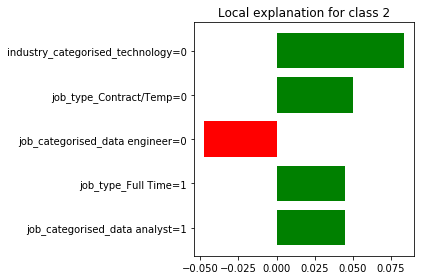

In [62]:
exp.show_in_notebook(show_all=False)

exp.as_pyplot_figure()
plt.tight_layout()

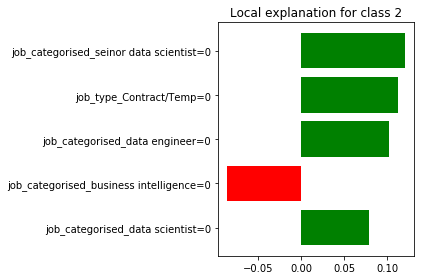

In [63]:
exp = explainer.explain_instance(X_test.values[observation_1],predict_fn_lr, num_features=5)
exp.show_in_notebook(show_all=False)

exp.as_pyplot_figure()
plt.tight_layout()

In [70]:
data.binned_sal.value_counts()

3    268
4    182
2     72
6     60
5     59
1     11
Name: binned_sal, dtype: int64

In [64]:
data[data['binned_sal'] ==1 ]

#     if x < 70000:
#         return 1
#     elif x < 100000:
#         return 2
#     elif x < 130000:
#         return 3
#     elif x < 160000:
#         return 4
#     elif x < 190000:
#         return 5
#     else:
#         return 6

,advertiser,industry,job_category,job_description,job_title,job_type,location,posting_date,sub_location,salary_cleaned,...,job_categorised_seinor business intelligence,job_categorised_seinor data analyst,job_categorised_seinor data engineer,job_categorised_seinor data scientist,location_Melbourne,location_Sydney,job_type_Contract/Temp,job_type_Full Time,binned_sal,binned_sal_2
58,Seventh Street Ventures,Information & Communication Technology,Business/Systems Analysts,About Us Seventh Street Venturesis an entrepre...,Data Analyst (Digital),Contract/Temp,Sydney,23 Apr 2019,"CBD, Inner West & Eastern Suburbs",60000.0,...,0,0,0,0,0,1,1,0,1,1
91,Sharp & Carter Finance and Accounting Sydney,Accounting,Accounts Officers/Clerks,About the role & Company This is a permanent o...,Master Data Analyst,Full Time,Sydney,8 May 2019,"CBD, Inner West & Eastern Suburbs",60000.0,...,0,0,0,0,0,1,0,1,1,1
184,HOBAN Recruitment,Accounting,Analysis & Reporting,Summary of qualities required.Do you have the ...,SAP Reporting/Data Analyst,Contract/Temp,Melbourne,15 May 2019,CBD & Inner Suburbs,67866.0,...,0,0,0,0,1,0,1,0,1,1
186,"Department of Environment, Land, Water and Pla...",Banking & Financial Services,Analysis & Reporting,We are building an inclusive workplace to help...,Data Analyst,Contract/Temp,Melbourne,10 May 2019,CBD & Inner Suburbs,67866.0,...,0,0,0,0,1,0,1,0,1,1
361,Aktana,Information & Communication Technology,Engineering - Software,POSITION SUMMARY We are looking for a talented...,Customer Success Engineer,Full Time,Sydney,27 Apr 2019,"CBD, Inner West & Eastern Suburbs",60000.0,...,0,0,0,0,0,1,0,1,1,1
391,Redwolf + Rosch,Information & Communication Technology,Engineering - Software,Want to work on the latest tech/ML and join a ...,JavaScript Engineer,Full Time,Melbourne,15 May 2019,CBD & Inner Suburbs,60000.0,...,0,0,0,0,1,0,0,1,1,1
398,Spark Recruitment,Information & Communication Technology,Sales - Pre & Post,Excellent training on offerMust hold a degree ...,Cyber Security Presales Engineer - Distinction...,Full Time,Melbourne,14 May 2019,CBD & Inner Suburbs,65000.0,...,0,0,0,0,1,0,0,1,1,1
403,Matrak,Information & Communication Technology,Web Development & Production,"Matrak is a rapidly growing, well funded, cons...",Graduate JavaScript Software Engineer,Full Time,Melbourne,9 May 2019,CBD & Inner Suburbs,60000.0,...,0,0,0,0,1,0,0,1,1,1
412,Symbiotech Pty Ltd,Information & Communication Technology,Engineering - Software,We're a young Melbourne-based software consult...,Graduate Software Engineer,Full Time,Melbourne,10 May 2019,CBD & Inner Suburbs,57000.0,...,0,0,0,0,1,0,0,1,1,1
477,Precision Sourcing,Information & Communication Technology,Developers/Programmers,Summary of the Team This is one of the most ex...,MSBI consultant,Contract/Temp,Sydney,29 Apr 2019,"CBD, Inner West & Eastern Suburbs",31200.0,...,0,0,0,0,0,1,1,0,1,1


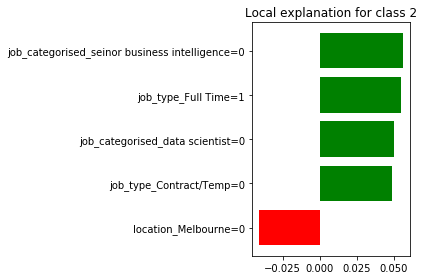

In [78]:
observation_1 = 184
exp = explainer.explain_instance(X_train.values[observation_1],predict_fn_svm, num_features=5)

exp.show_in_notebook(show_all=False)

exp.as_pyplot_figure()
plt.tight_layout()

In [66]:
from lime import submodular_pick

In [67]:
sp_obj=submodular_pick.SubmodularPick(explainer, X_train.values,predict_fn=predict_fn_svm,num_features=5,num_exps_desired=10)

C:\Users\Roy\Anaconda3\lib\site-packages\lime\submodular_pick.py:58: UserWarning: Requested sample size larger than
                              size of input data. Using all data
  size of input data. Using all data""")


In [68]:
[exp.show_in_notebook() for exp in sp_obj.sp_explanations]

[None, None, None, None, None, None, None, None, None, None]

## SHAP ON LR

More indepth interpretation using Shapley values. 

In [19]:
import shap

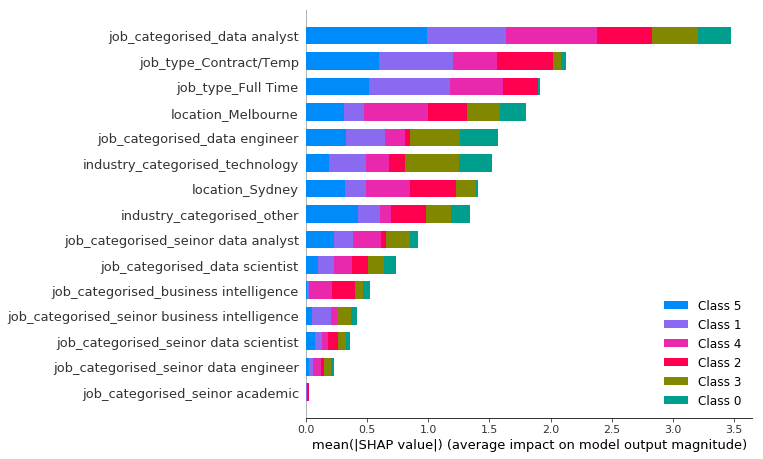

In [20]:
explainer = shap.LinearExplainer(lr,X_train,feature_dependence="independent")
shap_values = explainer.shap_values(X_test)
X_test_array = X_test.to_dense()
shap.summary_plot(shap_values,X_test_array)

In [21]:
explainer = shap.TreeExplainer(forest,X_train)
shap_values = explainer.shap_values(X_test)
X_test_array = X_test.to_dense()
shap.summary_plot(shap_values,X_test_array,plot_type="bar")

NameError: name 'forest' is not defined

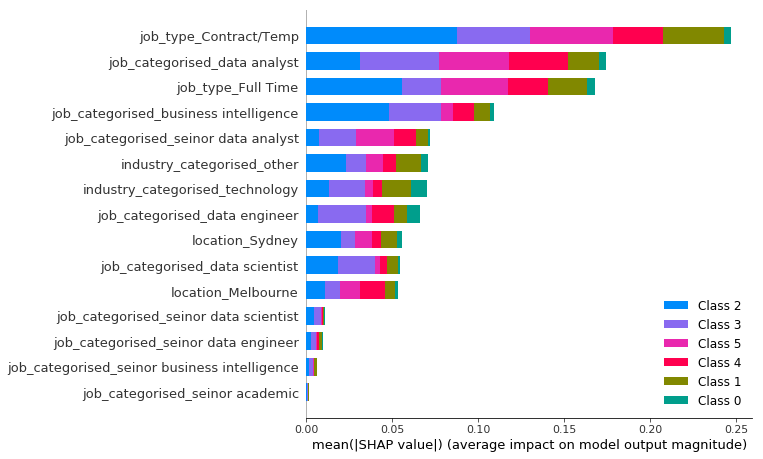

In [38]:
shap.summary_plot(shap_values,X_test_array)

Using 521 background data samples could cause slower run times. Consider using shap.kmeans(data, K) to summarize the background as K weighted samples.
  0%|          | 0/131 [00:00<?, ?it/s]C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the

  3%|▎         | 4/131 [00:02<01:16,  1.65it/s]C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.

C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
C:\User

C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
C:\User

C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
 13%|█▎

C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
 16%|█▌        | 21/131 [00:13<01:09,  1.59it/s]C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0

C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
 19%|█▉        | 25/131 [00:16<01:13,  1.43it/s]C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0

 22%|██▏       | 29/131 [00:19<01:12,  1.41it/s]C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0

C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
C:\User

C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
C:\User

C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
 32%|██

C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
 35%|███▌      | 46/131 [00:31<00:51,  1.66it/s]C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0

C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
 38%|███▊      | 50/131 [00:33<00:50,  1.61it/s]C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0

 41%|████      | 54/131 [00:35<00:46,  1.67it/s]C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0

C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
C:\User

C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
C:\User

C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
 51%|██

C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
 54%|█████▍    | 71/131 [00:46<00:35,  1.68it/s]C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0

C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
 57%|█████▋    | 75/131 [00:49<00:35,  1.56it/s]C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0

 60%|██████    | 79/131 [00:52<00:38,  1.35it/s]C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0

C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
C:\User

C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
C:\User

C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
 70%|██

C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
 73%|███████▎  | 96/131 [01:03<00:22,  1.58it/s]C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0

C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
 76%|███████▋  | 100/131 [01:05<00:18,  1.65it/s]C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v

 79%|███████▉  | 104/131 [01:07<00:15,  1.73it/s]C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v

C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
C:\User

C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
C:\User

C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
 89%|██

C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
 92%|█████████▏| 121/131 [01:17<00:05,  1.78it/s]C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v

C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
 95%|█████████▌| 125/131 [01:19<00:03,  1.79it/s]C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v

 98%|█████████▊| 129/131 [01:22<00:01,  1.79it/s]C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v0.29) the behavior will change from a " \
C:\Users\Roy\Anaconda3\lib\site-packages\shap\explainers\kernel.py:545: UserWarning: l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
  "l1_reg=\"auto\" is deprecated and in the next version (v

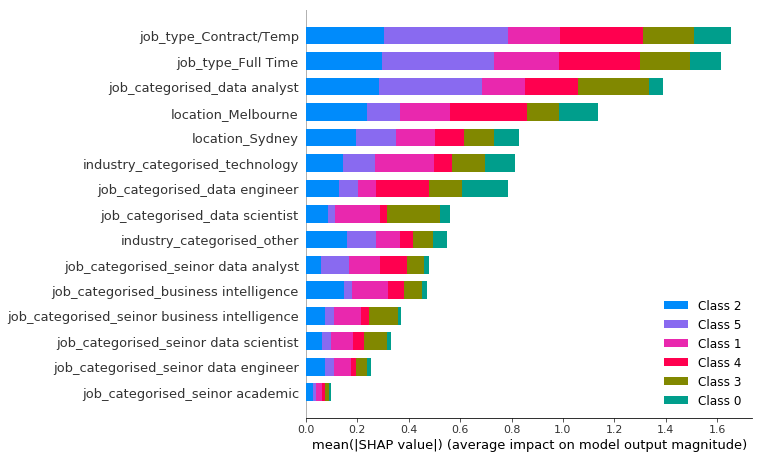

In [413]:
explainer = shap.KernelExplainer(svm.predict_proba, X_train, link="logit")
shap_values = explainer.shap_values(X_test, nsamples=100)
X_test_array = X_test.to_dense()
shap.summary_plot(shap_values,X_test_array,plot_type="bar")

## Learning Curves

In [373]:
from sklearn.model_selection import learning_curve, ShuffleSplit

In [379]:
def plot_learning_curve(estimator, title, X, y, ylim=None,cv=None,n_jobs=3,train_sizes=np.linspace(.1,1.0,5)):
    plt.figure()
    plt.title(title)
    if ylim is not None:
        plt.ylim(*ylim)
    plt.xlabel("Training Samples")
    plt.ylabel("Score")
    
    train_sizes, train_scores, test_scores = learning_curve(
        estimator, X, y, cv=cv, n_jobs=n_jobs, train_sizes=train_sizes)
    train_scores_mean = np.mean(train_scores, axis=1)
    train_scores_std = np.std(train_scores, axis=1)
    test_scores_mean = np.mean(test_scores, axis=1)
    test_scores_std = np.std(test_scores, axis=1)
    
    plt.grid()

    plt.fill_between(train_sizes, train_scores_mean - train_scores_std,
                     train_scores_mean + train_scores_std, alpha=0.1,
                     color="r")
    plt.fill_between(train_sizes, test_scores_mean - test_scores_std,
                     test_scores_mean + test_scores_std, alpha=0.1, color="g")
    plt.plot(train_sizes, train_scores_mean, 'o-', color="r",
             label="Training score")
    plt.plot(train_sizes, test_scores_mean, 'o-', color="g",
             label="Test score")

    plt.legend(loc="best")
    return plt

#### SVM Learning Curve

<module 'matplotlib.pyplot' from 'C:\\Users\\Roy\\Anaconda3\\lib\\site-packages\\matplotlib\\pyplot.py'>

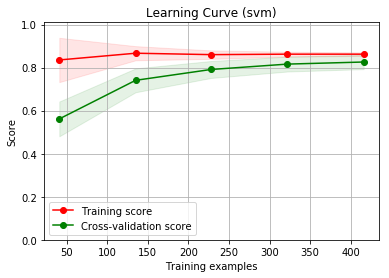

In [414]:
title = "Learning Curve (svm)"
cv = ShuffleSplit(n_splits=100, test_size=0.2, random_state=0)
estimator = svm
plot_learning_curve(estimator, title, X_train, y_train, ylim=(0.0, 1.01), cv=cv, n_jobs=3)

#### Logistic Regression Learning Curve

<module 'matplotlib.pyplot' from 'C:\\Users\\Roy\\Anaconda3\\lib\\site-packages\\matplotlib\\pyplot.py'>

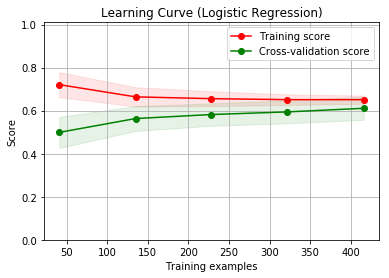

In [395]:
title = "Learning Curve (Logistic Regression)"
cv = ShuffleSplit(n_splits=100, test_size=0.2, random_state=0)
estimator = lr
plot_learning_curve(estimator, title, X_train, y_train, ylim=(0.0, 1.01), cv=cv, n_jobs=3)


#### XG Boost Learning Curve

<module 'matplotlib.pyplot' from 'C:\\Users\\Roy\\Anaconda3\\lib\\site-packages\\matplotlib\\pyplot.py'>

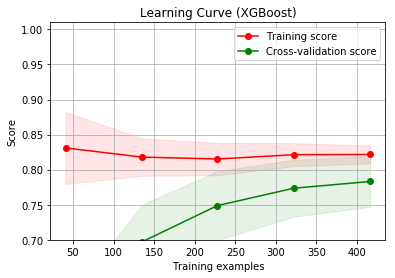

In [393]:
title = "Learning Curve (XGBoost)"
cv = ShuffleSplit(n_splits=100, test_size=0.2, random_state=0)
estimator = model
plot_learning_curve(estimator, title, X_train, y_train, ylim=(0.1, 1.01), cv=cv, n_jobs=3)


<module 'matplotlib.pyplot' from 'C:\\Users\\Roy\\Anaconda3\\lib\\site-packages\\matplotlib\\pyplot.py'>

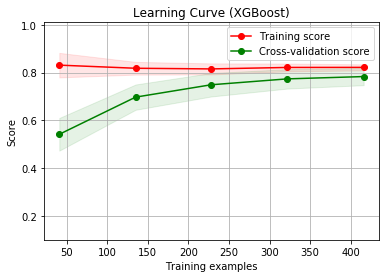

In [394]:
plot_learning_curve(estimator, title, X_train, y_train, ylim=(0.1, 1.01), cv=cv, n_jobs=3)